# Drone Data Evaluation

In [1]:
import os
import sys
import cv2
import glob
import numpy as np
from time import time
from matplotlib import colors
import matplotlib.pyplot as plt
from skimage.transform import resize

import tensorflow as tf
from tensorflow.keras.utils import plot_model, to_categorical
from tensorflow.keras.preprocessing.image import array_to_img, img_to_array, load_img
from utils.data_utils import get_labels, parse_record, get_dataset_from_tfrecord

from collections import namedtuple
print("Tensorflow version: ", tf.__version__)

%config InlineBackend.figure_format = 'retina'
plt.style.use('ggplot')
plt.rc('xtick',labelsize=16)
plt.rc('ytick',labelsize=16)

Tensorflow version:  2.4.1


In [2]:
n_classes = 20

labels = get_labels() # a list of named tuples
catid2label = { label.categoryId : label for label in labels }
trainid2label = { label.trainId : label for label in labels }

In [30]:
def label_to_rgb(mask):
    h = mask.shape[0]
    w = mask.shape[1]
    mask_rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for val, key in trainid2label.items():
        indices = mask == val
        mask_rgb[indices.squeeze()] = key.color 
    return mask_rgb


def rgb_to_label(mask):
    mask = mask.astype(np.uint8)
    h = mask.shape[0]
    w = mask.shape[1]
    mask_label = np.zeros((h, w, 1), dtype=np.uint8)
    for val, key in trainid2label.items():
        if val != -1:
            color = key.color
            indices = np.all(mask == color, axis=2)
            mask_label[indices.squeeze()] = val
    return mask_label


def display(display_list, title=True):
    plt.figure(figsize=(15, 5), dpi=100) # dpi=200
    if title:
        title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        if title:
            plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [4]:
img_file = "drone_data/All/JPEGImages/00001_img.png"
mask_file = "drone_data/All/SegmentationClass/00001_mask.png"

image = img_to_array(load_img(img_file))
mask = img_to_array(load_img(mask_file))

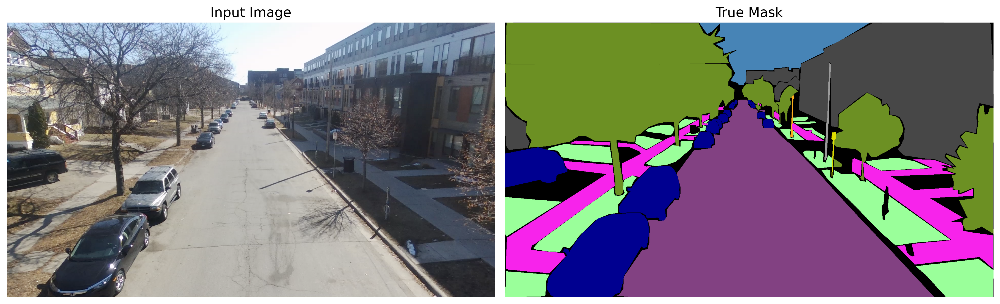

In [5]:
display([image, mask])

In [6]:
img_height = 1024
img_width = 2048

data_dir = "drone_data"
task = "All"
img_dir = "JPEGImages"
mask_dir = "SegmentationClass"
img_pattern = "*_img.png"
mask_pattern = "*_mask.png"

search_image_files = os.path.join(data_dir, task, img_dir, img_pattern)
search_mask_files = os.path.join(data_dir, task, mask_dir, mask_pattern)
image_list = sorted(glob.glob(search_image_files))
mask_list = sorted(glob.glob(search_mask_files))
assert len(image_list) == len(mask_list)
# print(image_list)
# print(mask_list)

In [7]:
def get_data(image_files, mask_files):
    
    n_samples = len(image_files)
    
    X = np.zeros((n_samples, img_height, img_width, 3), dtype=np.uint8)
    y = np.zeros((n_samples, img_height, img_width, 1))
    
    for i, (img_file, mask_file) in enumerate(zip(image_files, mask_files)):
        print("\r Processing {} / {}".format(i+1, n_samples), end='')
        x_img = img_to_array(load_img(img_file))
        x_img = x_img.squeeze()
        x_img = resize(x_img, (1024, 2048, 3), mode='constant', preserve_range = True)
        x_img = x_img.astype(np.uint8)
 
        X[i] = x_img
        
        mask = img_to_array(load_img(mask_file))
        mask = rgb_to_label(mask)
        mask = mask.squeeze()
        mask = cv2.resize(mask, (2048, 1024), interpolation = cv2.INTER_NEAREST)
        mask = np.expand_dims(mask, 2)
        mask = mask.astype(np.uint8)    
        
        y[i] = mask
        
    R_MEAN = np.mean(X[:,:,:,0] / 255)
    G_MEAN = np.mean(X[:,:,:,1] / 255)
    B_MEAN = np.mean(X[:,:,:,2] / 255)

    R_STD = np.std(X[:,:,:,0] / 255)
    G_STD = np.std(X[:,:,:,1] / 255)
    B_STD = np.std(X[:,:,:,2] / 255)
    
    print()
    print("Mean: ", R_MEAN, G_MEAN, B_MEAN)
    print("Std: ", R_STD, G_STD, B_STD)
        
    return X, y

In [8]:
X, y = get_data(image_files=image_list, mask_files=mask_list)

 Processing 92 / 92
Mean:  0.49795178462578765 0.4943920119644106 0.4656040777432432
Std:  0.1914894889544509 0.1947733842463524 0.2098071211579494


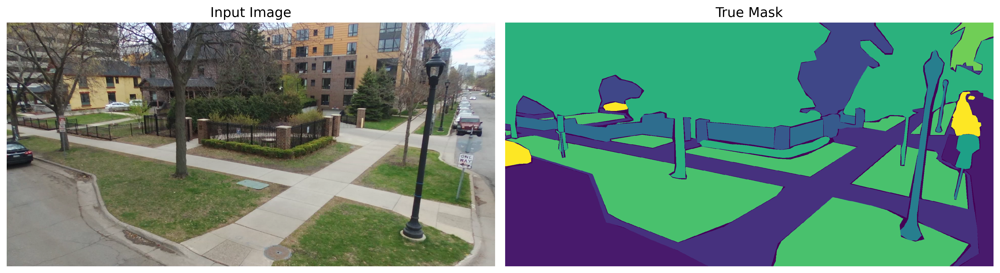

In [9]:
idx = 87
display([X[idx], y[idx]])

In [10]:
y[idx].mean()

6.406676769256592

## Check dataset and input pipeline

In [11]:
img_height = 512
img_width = 1024

In [12]:
MEAN = np.array([0.49795, 0.49439, 0.46560])
STD = np.array([0.19149, 0.19477, 0.20980])

def normalize(image, mask):
    image = image / 255.0
    image = image - MEAN
    image = image / STD
    return image, mask


def mask_to_categorical(image, mask):
    mask = tf.squeeze(mask)
    mask = tf.one_hot(tf.cast(mask, tf.int32), n_classes)
    mask = tf.cast(mask, tf.float32)
    return image, mask


def load_image_test(input_image, input_mask):
    image = tf.image.resize(input_image, (img_height, img_width))
    # mask = tf.image.resize(input_mask, (img_height, img_width))
       
    image, mask = normalize(tf.cast(image, tf.float32), input_mask)
    # image, mask = mask_to_categorical(image, mask)
    mask = tf.cast(mask, tf.float32)
    mask = tf.squeeze(mask)
    return image, mask

In [13]:
drone_dataset = tf.data.Dataset.from_tensor_slices((X, y))

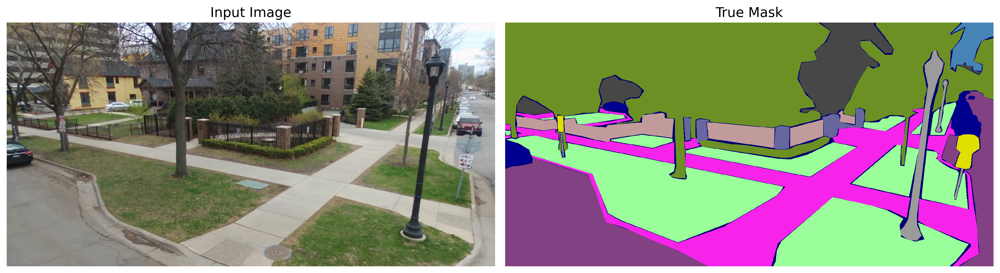

In [16]:
for i, (image, mask) in enumerate(drone_dataset.take(88)):
    sample_image, sample_mask = image.numpy(), mask.numpy()
    
sample_mask = label_to_rgb(sample_mask)
display([sample_image, sample_mask])

In [17]:
dataset = drone_dataset.map(load_image_test)

In [19]:
for i, (image, mask) in enumerate(dataset.take(88)):
    preprocessed_image, preprocessed_mask = image, mask
    
print(preprocessed_mask.numpy().shape)

(1024, 2048)


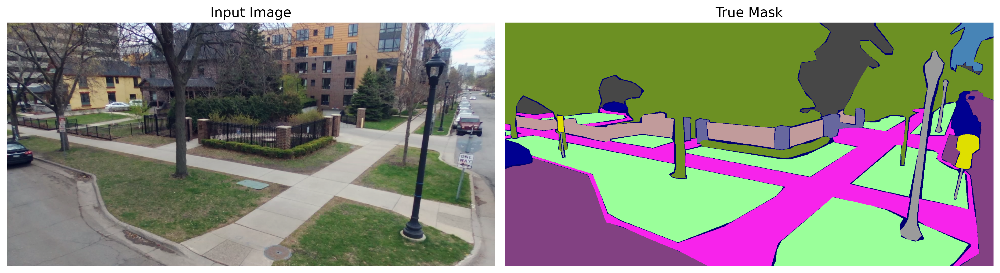

In [20]:
# preprocessed_mask = tf.argmax(preprocessed_mask, axis=-1)
preprocessed_mask = preprocessed_mask[..., tf.newaxis]
preprocessed_mask = label_to_rgb(preprocessed_mask.numpy())
display([preprocessed_image, preprocessed_mask])

## Evaluate

In [21]:
from models.u2net_logits import U2NET

In [22]:
def evaluate_iou(model, dataset, n_samples):
    
    inf_times = np.zeros((n_samples, ))
    predictions = np.zeros((n_samples, 1024, 2048, 1))
    miou_op =  tf.keras.metrics.MeanIoU(num_classes=n_classes-1)
    
    for idx, (image, mask) in enumerate(dataset):
        print("\r Predicting {} \ {} ".format(idx+1, n_samples), end='')
        
        X = np.expand_dims(image.numpy(), axis=0)
        y_true = np.expand_dims(mask.numpy(), axis=0)
        
        t_start = time()
        y_pred = model.predict(X)
        t_end = time()
        t_inf = t_end-t_start
        
        inf_times[idx] = t_inf
        
        if "U2Net" in model.name:
            y_pred = y_pred[0]
            
        y_pred = tf.image.resize(y_pred, (1024, 2048))
        threshold = tf.math.reduce_max(y_pred, axis=-1, keepdims=True)
        y_pred = tf.logical_and(y_pred >= threshold, tf.abs(y_pred) > 1e-12)
        
        y_pred = tf.cast(tf.squeeze(y_pred, axis=0), tf.int32)
        predictions[idx] = tf.expand_dims(tf.argmax(y_pred, axis=-1), axis=-1)
        
        
        y_true = tf.cast(tf.squeeze(y_true, axis=0), tf.int32)
        y_true = tf.one_hot(tf.cast(y_true, tf.int32), n_classes)
        y_true = tf.argmax(y_true[:,:,1:], axis=-1)
        
        y_pred = tf.argmax(y_pred[:,:,1:], axis=-1)
                
        miou_op.update_state(y_true, y_pred)
        
        if idx == (n_samples-1):
            break
    
    print("Average inference time: {:.2f}s".format(np.mean(inf_times)))
            
    return miou_op, predictions

In [23]:
def plot_iou_trainId(trainId_label_map, catId_label_map, n_classes, iou_class, model, iou_mean):

    categories = [trainId_label_map[i].category for i in range(1, n_classes)]
    
    cat_colors = {
        'void': colors.to_hex(list(np.array(catId_label_map[0].color)/255)),
        'flat': colors.to_hex(list(np.array(catId_label_map[1].color)/255)),
        'construction': colors.to_hex(list(np.array(catId_label_map[2].color)/255)),
        'object': colors.to_hex(list(np.array(catId_label_map[3].color)/255)),
        'nature': colors.to_hex(list(np.array(catId_label_map[4].color)/255)),
        'sky': colors.to_hex(list(np.array(catId_label_map[5].color)/255)),
        'human': colors.to_hex(list(np.array(catId_label_map[6].color)/255)),
        'vehicle': colors.to_hex(list(np.array(catId_label_map[7].color)/255))
    }
    _colors = [cat_colors[category] for category in categories]

    names = [trainId_label_map[i].name for i in range(1, n_classes)]

    fig, ax = plt.subplots(figsize=(14,10))
    hbars = ax.barh(names, iou_class, color=_colors)
    
    ax.set_xlabel("IoU Coefficient: ", fontsize=18)
    ax.set_ylabel("Class Name", fontsize=18)
    ax.set_title("Class Scores for {} - Mean IoU: {:.3f}".format(model.name, iou_mean), fontsize=22)
    ax.set_xlim([0, 1])
    
    ax.bar_label(hbars, fmt="%.2f", padding=3, fontsize=16)
    
    plt.savefig("plots/"+model.name+"_class_iou_scores.png")
    plt.show()

In [24]:
model = U2NET(input_height=img_height, input_width=img_width, n_classes=20)

In [25]:
model.load_weights("weights/U2Net.h5")

In [26]:
miou_op, y_pred = evaluate_iou(model=model, dataset=dataset, n_samples=len(X))
iou_mean = miou_op.result().numpy()

 Predicting 92 \ 92 Average inference time: 3.93s


In [27]:
union_int = np.sum(miou_op.get_weights()[0], axis=0)+np.sum(miou_op.get_weights()[0], axis=1)
inters = np.diag(miou_op.get_weights()[0])
ious = inters / (union_int-inters+1)

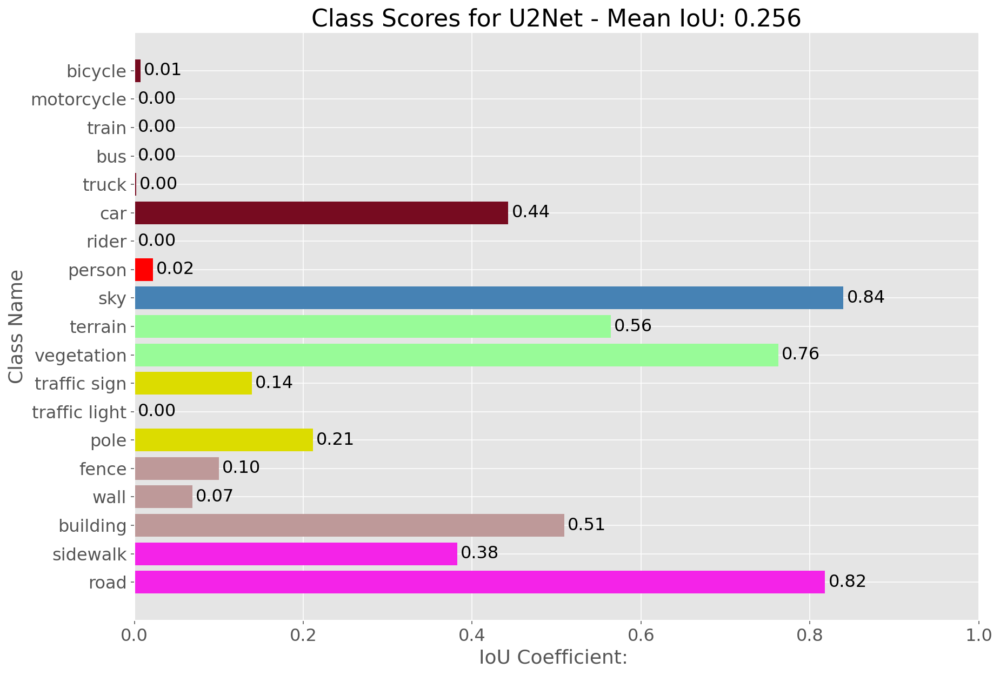

In [28]:
plot_iou_trainId(
    trainId_label_map=trainid2label,
    catId_label_map=catid2label, 
    n_classes=n_classes, 
    iou_class=ious,
    model=model, 
    iou_mean=iou_mean,
)

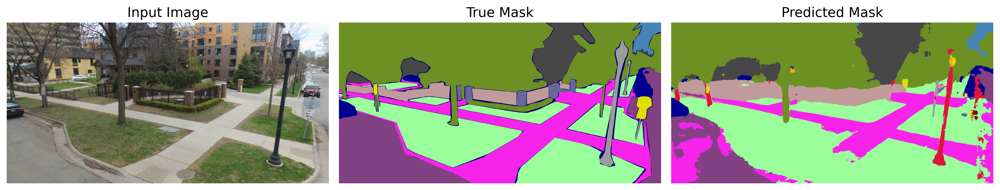

In [29]:
idx = 87
display([X[idx], label_to_rgb(y[idx]), label_to_rgb(y_pred[idx])])

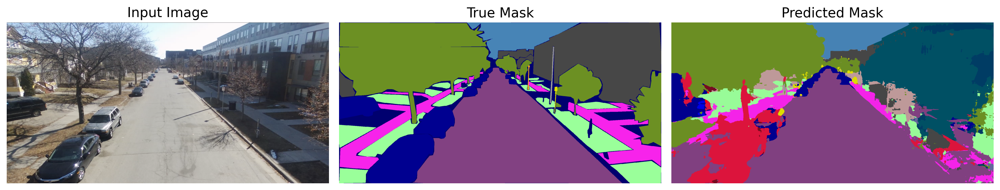

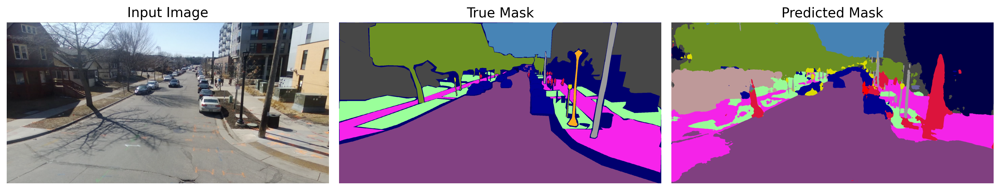

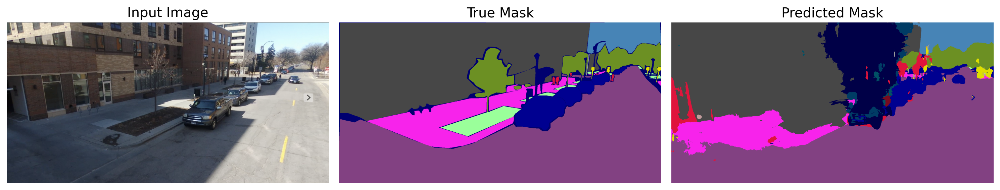

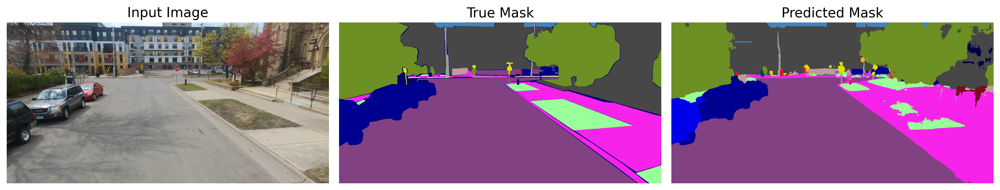

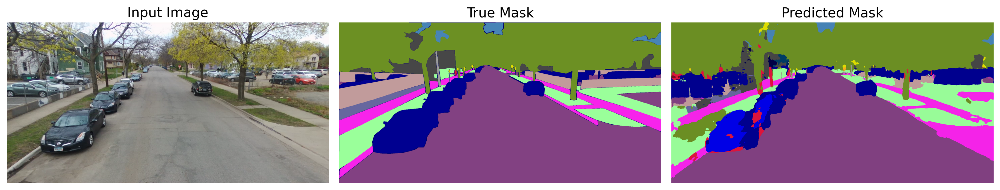

...

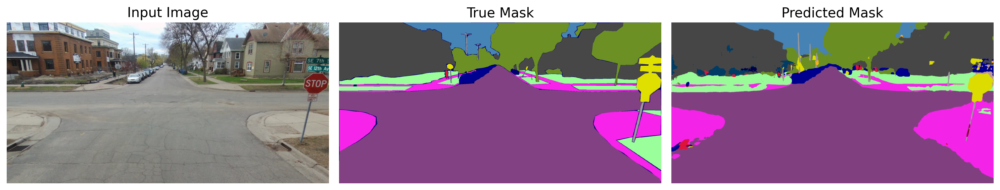

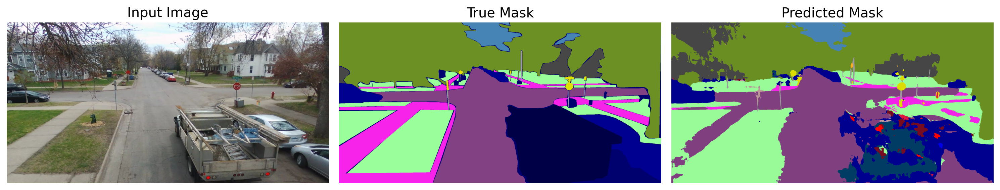

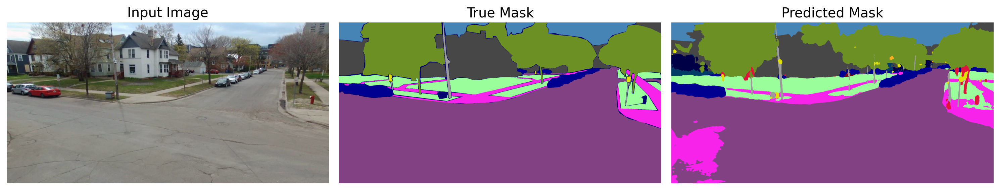

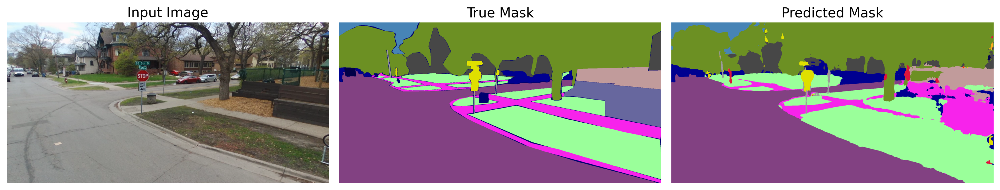

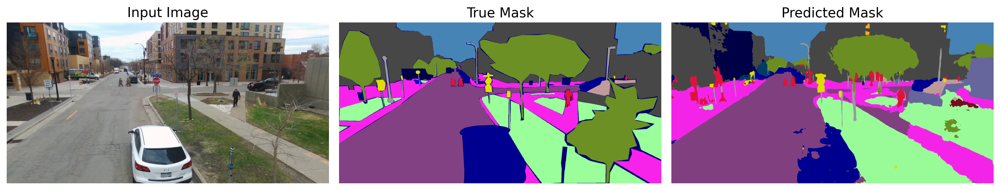

In [32]:
for idx in range(0,len(X), 5):
    display([X[idx], label_to_rgb(y[idx]), label_to_rgb(y_pred[idx])])